## Module d'estimation de biens immobilier
## Estimation des appartements et des maisons

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import RandomForestRegressor



In [14]:
# read file 
df_val_fonc = pd.read_csv('../valeursfoncieres-2019.txt', sep = '|',  decimal = ',' , encoding='UTF-8')
#print(df_val_fonc.head())
#drop empty columns 
df_val_fonc = df_val_fonc.drop(['Code service CH', 'Reference document', '1 Articles CGI', '2 Articles CGI', '3 Articles CGI', '4 Articles CGI', '5 Articles CGI', 'No disposition','Identifiant local'], axis = 1)
#faire un groupby
df_val_fonc = df_val_fonc.groupby(['Date mutation', 'Nature mutation','Valeur fonciere','No voie','Voie','Code postal','Commune','Code departement','No plan','Type local','Code type local'])['Surface reelle bati','Nombre pieces principales'].sum().reset_index()
#
df_val_fonc = df_val_fonc.drop(['Date mutation', 'No voie','No plan','Code type local'], axis = 1)
# # lines  filter
df_val_fonc = df_val_fonc.dropna()
df_val_fonc.drop_duplicates(inplace = True)
# 

df_val_fonc_App = df_val_fonc.loc[(df_val_fonc['Nature mutation']=="Vente") & (df_val_fonc['Type local']=="Appartement"),:]
df_val_fonc_App = df_val_fonc_App.drop(['Nature mutation','Type local'], axis = 1)


In [15]:

df_val_fonc_App.drop(df_val_fonc_App[(df_val_fonc_App['Valeur fonciere']< 7000.00)|(df_val_fonc['Valeur fonciere'].isna())].index, inplace = True)
df_val_fonc_App.drop(df_val_fonc_App[df_val_fonc_App['Valeur fonciere']> 20000000.00].index, inplace = True)
#
df_val_fonc_App.drop(df_val_fonc_App[df_val_fonc_App['Surface reelle bati']< 9.00].index, inplace = True)


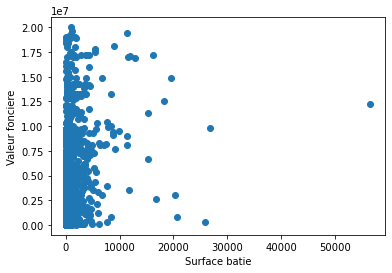

In [16]:

#
plt.scatter(df_val_fonc_App["Surface reelle bati"], df_val_fonc_App["Valeur fonciere"])
plt.xlabel("Surface batie")
plt.ylabel("Valeur fonciere")
plt.show()

<AxesSubplot:>

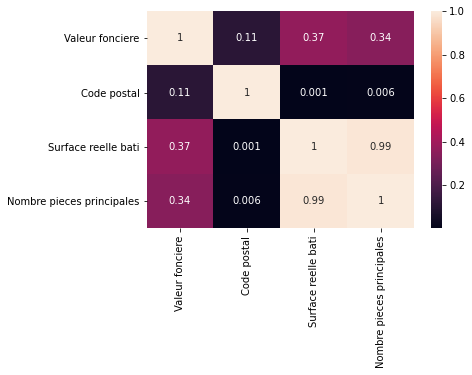

In [17]:
matrice_corr = df_val_fonc_App.corr().round(3)
sns.heatmap(data = matrice_corr, annot=True)

## Linear regression model

In [36]:
columns = df_val_fonc_App.columns.tolist()
# Filtrer les colonnes pour supprimer celles que nous ne voulons pas.
columns = [c for c in columns if c not in ["Valeur fonciere","Voie", "Commune", "Code departement"]]
#stocker la variable à prédire
target = "Valeur fonciere"
# générer l'ensemble de données pour l'apprentissage, définir un état aléatoire pour reproduire les résultats
train = df_val_fonc_App.sample(frac=0.8, random_state=1)

# selectionner un autre ensemble qui n'est pas dans l'apprentissage
test = df_val_fonc_App.loc[~df_val_fonc_App.index.isin(train.index)]
# Initialiser la classe du modèle
lin_model = LinearRegression()
# Ajuster le modèle aux données d'apprentissage (fit the model to the training data)
lin_model.fit(train[columns], train[target])
#lin_model.fit(test[columns], test[target])
# générer les predictions
lin_predictions = lin_model.predict(test[columns]).round(3)
#print("Predictions:", lin_predictions)
print('Values test : ', test[target][:5])
print('Predict Values predict : ', lin_predictions[:5])
# calcul d'erreur entre les prédictions et les valeurs fournies
lin_mse = mean_squared_error(lin_predictions,test[target]).round(3)
print("Computed error:", lin_mse)
#lin_model.score(test[columns],train[target])
lin_model.score(test[columns], test[target])

Values test :  0      80000.0
212     9000.0
262    13650.0
300    16000.0
412    25000.0
Name: Valeur fonciere, dtype: float64
Predict Values predict :  [333852.446 353003.637 212021.85  276921.273 163358.315]
Computed error: 265343349590.756


0.039438604364851915

## Polynomial regression

## Random forest model

In [41]:
# Initialiser le modèle avec certains paramètres
Model_RF = RandomForestRegressor(n_estimators = 100, min_samples_leaf = 15, random_state = 1)
# Adapter le modèle aux données
Model_RF.fit(train[columns], train[target])
#Model_RF.fit(X_test, Y_test)
#
# générer les prédictions
predictions_RF = Model_RF.predict(test[columns])
#print("Predictions:", predictions_RF)
print('Values test : ', test[target][:5])
print('Predict Values predict : ', predictions_RF [:5])
# calcul d'erreur entre les prédictions et les valeurs réelles
mean_squared_error(predictions_RF, test[target])
#calcul du score
Model_RF.score(test[columns], test[target])




Values test :  0      80000.0
212     9000.0
262    13650.0
300    16000.0
412    25000.0
Name: Valeur fonciere, dtype: float64
Predict Values predict :  [ 173122.85653807 1338413.98306295  536936.7104253    50692.46040419
   93440.07436465]


0.5240729452071851

## appliquer le modèle au cas des maisons

In [14]:
df_val_fonc_maison = df_val_fonc.loc[(df_val_fonc['Nature mutation']=="Vente") & (df_val_fonc['Type local']=="maison"),:]
df_val_fonc_maison = df_val_fonc_maison.drop(['Nature mutation','Type local'], axis = 1)
#
df_val_fonc_maison.drop(df_val_fonc_maison[(df_val_fonc_maison['Valeur fonciere']< 10000.00)|(df_val_fonc['Valeur fonciere'].isna())].index, inplace = True)
df_val_fonc_maison.drop(df_val_fonc_maison[df_val_fonc_maison['Valeur fonciere']> 20000000.00].index, inplace = True)
#
df_val_fonc_maison.drop(df_val_fonc_maison[df_val_fonc_maison['Surface reelle bati']< 30].index, inplace = True)




In [42]:
# Selecting Features
x = df_val_fonc_App[['Code postal','Surface reelle bati','Nombre pieces principales']]
# Selecting Target 
y = df_val_fonc_App[['Valeur fonciere']]
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=1, shuffle =True)
#
#np.isfinite(X_test).all()
model_RF = RandomForestRegressor(n_estimators = 100, min_samples_leaf = 15, random_state = 1)
model_RF.fit(x_train, y_train)
model_RF.fit(x_test, y_test)
#
lin_predictions_FR = model_RF.predict(x_test)
#
print('Values test : ', y_test[:5])
print('Predict Values predict : ', lin_predictions_FR[:5])
#lin_mse = mean_squared_error(lin_predictions, y)
#
model_RF.score(x_train, y_train)
model_RF.score(x_test, y_test)
#


Values test :          Valeur fonciere
480619         197000.0
764492         257000.0
957486          85000.0
161522         258000.0
962366          85000.0
Predict Values predict :  [159595.31411233 244482.00887919 105116.29356729 195809.45311379
  74427.38686005]


0.5686876279141158